In [111]:
# importing libraries 
import matplotlib
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
plt.style.use('ggplot')
import seaborn as sns
%matplotlib inline
from matplotlib.pyplot import figure
matplotlib.rcParams['figure.figsize'] = (12,8)


In [5]:
data = pd.read_csv(r'C:\Users\Admin\Desktop\portfolio projects\movies.csv')

In [6]:
data

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
0,The Shining,R,Drama,1980,"June 13, 1980 (United States)",8.4,927000.0,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000.0,46998772.0,Warner Bros.,146.0
1,The Blue Lagoon,R,Adventure,1980,"July 2, 1980 (United States)",5.8,65000.0,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000.0,58853106.0,Columbia Pictures,104.0
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,"June 20, 1980 (United States)",8.7,1200000.0,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000.0,538375067.0,Lucasfilm,124.0
3,Airplane!,PG,Comedy,1980,"July 2, 1980 (United States)",7.7,221000.0,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000.0,83453539.0,Paramount Pictures,88.0
4,Caddyshack,R,Comedy,1980,"July 25, 1980 (United States)",7.3,108000.0,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000.0,39846344.0,Orion Pictures,98.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7663,More to Life,NaN,Drama,2020,"October 23, 2020 (United States)",3.1,18.0,Joseph Ebanks,Joseph Ebanks,Shannon Bond,United States,7000.0,NaN,NaN,90.0
7664,Dream Round,NaN,Comedy,2020,"February 7, 2020 (United States)",4.7,36.0,Dusty Dukatz,Lisa Huston,Michael Saquella,United States,NaN,NaN,Cactus Blue Entertainment,90.0
7665,Saving Mbango,NaN,Drama,2020,"April 27, 2020 (Cameroon)",5.7,29.0,Nkanya Nkwai,Lynno Lovert,Onyama Laura,United States,58750.0,NaN,Embi Productions,NaN
7666,It's Just Us,NaN,Drama,2020,"October 1, 2020 (United States)",NaN,NaN,James Randall,James Randall,Christina Roz,United States,15000.0,NaN,NaN,120.0


In [7]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7668 entries, 0 to 7667
Data columns (total 15 columns):
name        7668 non-null object
rating      7591 non-null object
genre       7668 non-null object
year        7668 non-null int64
released    7666 non-null object
score       7665 non-null float64
votes       7665 non-null float64
director    7668 non-null object
writer      7665 non-null object
star        7667 non-null object
country     7665 non-null object
budget      5497 non-null float64
gross       7479 non-null float64
company     7651 non-null object
runtime     7664 non-null float64
dtypes: float64(5), int64(1), object(9)
memory usage: 898.7+ KB


In [37]:
#looking for null values

for col in data.columns:
    percentage_missing=np.mean(data[col].isnull())
    print('{} - {}%'.format(col, [percentage_missing*100]) )
    

name - [0.0]%
rating - [1.004173187271779]%
genre - [0.0]%
year - [0.0]%
released - [0.02608242044861763]%
score - [0.03912363067292645]%
votes - [0.03912363067292645]%
director - [0.0]%
writer - [0.03912363067292645]%
star - [0.013041210224308816]%
country - [0.03912363067292645]%
budget - [28.31246739697444]%
gross - [2.464788732394366]%
company - [0.2217005738132499]%
runtime - [0.05216484089723526]%


In [41]:
# As we want to find the coorelation we will drop the null values.

Clean_data=data.dropna()
Clean_data

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
0,The Shining,R,Drama,1980,"June 13, 1980 (United States)",8.4,927000.0,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000.0,46998772.0,Warner Bros.,146.0
1,The Blue Lagoon,R,Adventure,1980,"July 2, 1980 (United States)",5.8,65000.0,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000.0,58853106.0,Columbia Pictures,104.0
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,"June 20, 1980 (United States)",8.7,1200000.0,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000.0,538375067.0,Lucasfilm,124.0
3,Airplane!,PG,Comedy,1980,"July 2, 1980 (United States)",7.7,221000.0,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000.0,83453539.0,Paramount Pictures,88.0
4,Caddyshack,R,Comedy,1980,"July 25, 1980 (United States)",7.3,108000.0,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000.0,39846344.0,Orion Pictures,98.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7648,Bad Boys for Life,R,Action,2020,"January 17, 2020 (United States)",6.6,140000.0,Adil El Arbi,Peter Craig,Will Smith,United States,90000000.0,426505244.0,Columbia Pictures,124.0
7649,Sonic the Hedgehog,PG,Action,2020,"February 14, 2020 (United States)",6.5,102000.0,Jeff Fowler,Pat Casey,Ben Schwartz,United States,85000000.0,319715683.0,Paramount Pictures,99.0
7650,Dolittle,PG,Adventure,2020,"January 17, 2020 (United States)",5.6,53000.0,Stephen Gaghan,Stephen Gaghan,Robert Downey Jr.,United States,175000000.0,245487753.0,Universal Pictures,101.0
7651,The Call of the Wild,PG,Adventure,2020,"February 21, 2020 (United States)",6.8,42000.0,Chris Sanders,Michael Green,Harrison Ford,Canada,135000000.0,111105497.0,20th Century Studios,100.0


In [43]:
# we have dropped the null values lets verify it

for col in Clean_data.columns:
    percentage_missing=np.mean(Clean_data[col].isnull())
    print('{} - {}%'.format(col, [percentage_missing*100]) )

name - [0.0]%
rating - [0.0]%
genre - [0.0]%
year - [0.0]%
released - [0.0]%
score - [0.0]%
votes - [0.0]%
director - [0.0]%
writer - [0.0]%
star - [0.0]%
country - [0.0]%
budget - [0.0]%
gross - [0.0]%
company - [0.0]%
runtime - [0.0]%


In [44]:
#let's see the data types of all the column

Clean_data.dtypes

name         object
rating       object
genre        object
year          int64
released     object
score       float64
votes       float64
director     object
writer       object
star         object
country      object
budget      float64
gross       float64
company      object
runtime     float64
dtype: object

In [126]:
#lets see the gross revenue by descending order

clean_data_sorted=Clean_data.sort_values(by=['gross'], inplace=False, ascending=False)

In [71]:
# les see all of the data

pd.set_option('display.max_rows',None)



In [74]:
# lets see if we have duplicate values

Clean_data.company.drop_duplicates().count()  

#We are not dropping any duplicates here as we dont want to lose that much of data but this is also a possible solution to identify the distinct values inside the column company

1475

In [76]:
#lets see if the above solution for checking the distinct values, we will check the count using the nunique() method.
Clean_data.company.nunique()

1475

Text(0, 0.5, 'Gross revenue of the film')

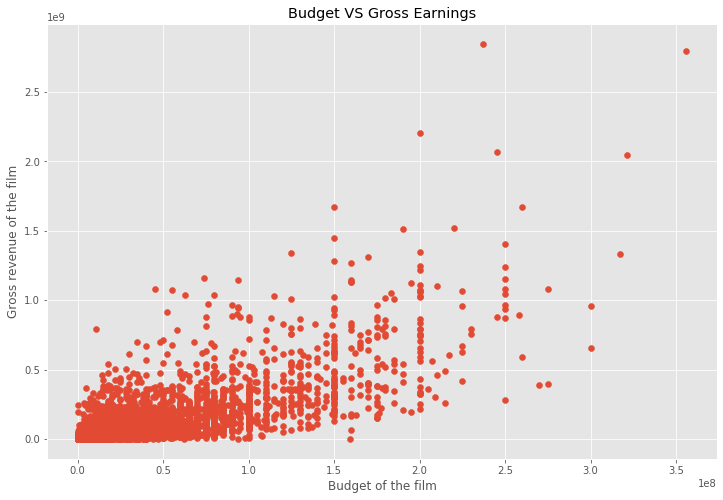

In [112]:
# lets identify which variable is most coorelated to the gross columns. lets identify that if a movie has more budget does that releates to the gross revenue.

# we will idnetify the coorelation by plotting it, we will use scatterplot for it.

plt.scatter(x=Clean_data.budget, y=Clean_data.gross)
plt.title('Budget VS Gross Earnings')
plt.xlabel('Budget of the film')
plt.ylabel('Gross revenue of the film')


In [94]:
# lets see if what we have plottes is right or not. lets see for the budget of the film which is close to 2.5 million and gross revenue of the film which is more than 2.5 million.

Clean_data.sort_values(by=['gross'], ascending=False)

#yes what we have ploted is right.

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
5445,Avatar,PG-13,Action,2009,"December 18, 2009 (United States)",7.8,1100000.0,James Cameron,James Cameron,Sam Worthington,United States,237000000.0,2.847246e+09,Twentieth Century Fox,162.0
7445,Avengers: Endgame,PG-13,Action,2019,"April 26, 2019 (United States)",8.4,903000.0,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,356000000.0,2.797501e+09,Marvel Studios,181.0
3045,Titanic,PG-13,Drama,1997,"December 19, 1997 (United States)",7.8,1100000.0,James Cameron,James Cameron,Leonardo DiCaprio,United States,200000000.0,2.201647e+09,Twentieth Century Fox,194.0
6663,Star Wars: Episode VII - The Force Awakens,PG-13,Action,2015,"December 18, 2015 (United States)",7.8,876000.0,J.J. Abrams,Lawrence Kasdan,Daisy Ridley,United States,245000000.0,2.069522e+09,Lucasfilm,138.0
7244,Avengers: Infinity War,PG-13,Action,2018,"April 27, 2018 (United States)",8.4,897000.0,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,321000000.0,2.048360e+09,Marvel Studios,149.0
7480,The Lion King,PG,Animation,2019,"July 19, 2019 (United States)",6.9,222000.0,Jon Favreau,Jeff Nathanson,Donald Glover,United States,260000000.0,1.670728e+09,Walt Disney Pictures,118.0
6653,Jurassic World,PG-13,Action,2015,"June 12, 2015 (United States)",7.0,593000.0,Colin Trevorrow,Rick Jaffa,Chris Pratt,United States,150000000.0,1.670516e+09,Universal Pictures,124.0
6043,The Avengers,PG-13,Action,2012,"May 4, 2012 (United States)",8.0,1300000.0,Joss Whedon,Joss Whedon,Robert Downey Jr.,United States,220000000.0,1.518816e+09,Marvel Studios,143.0
6646,Furious 7,PG-13,Action,2015,"April 3, 2015 (United States)",7.1,370000.0,James Wan,Chris Morgan,Vin Diesel,United States,190000000.0,1.515341e+09,Universal Pictures,137.0
7494,Frozen II,PG,Animation,2019,"November 22, 2019 (United States)",6.8,148000.0,Chris Buck,Jennifer Lee,Kristen Bell,United States,150000000.0,1.450027e+09,Walt Disney Animation Studios,103.0


Text(0, 0.5, 'Gross revenue of the film')

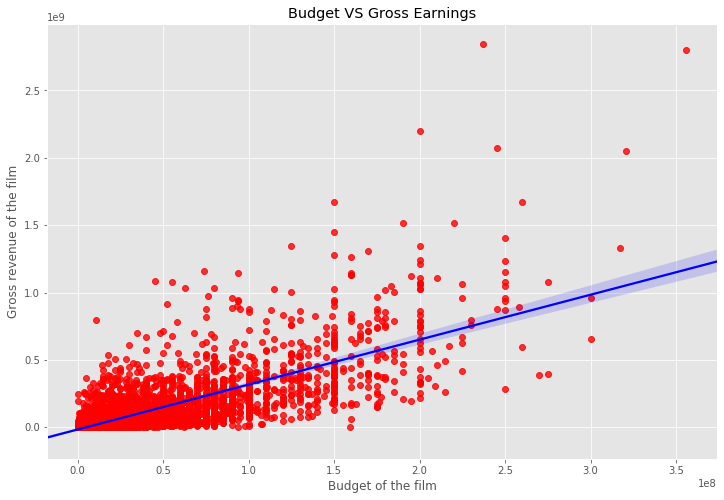

In [113]:
#lets do a reg plot so that we can get more idea about the coorelation between  budget and gross.
# we will use sns for this

sns.regplot(x=Clean_data.budget, y=Clean_data.gross, scatter_kws={"color" : "Red"}, line_kws={"color" : "blue"})
plt.title('Budget VS Gross Earnings')
plt.xlabel('Budget of the film')
plt.ylabel('Gross revenue of the film')

In [100]:
# we can predict that they are coorelated 
#lets check it using corr()
Clean_data.corr()
# we can notice that budget and gross has a coorelation of 0.74 which is highest amongst all.

,year,score,votes,budget,gross,runtime
year,1.000000,0.056386,0.206021,0.327722,0.274321,0.075077
score,0.056386,1.000000,0.474256,0.072001,0.222556,0.414068
votes,0.206021,0.474256,1.000000,0.439675,0.614751,0.352303
budget,0.327722,0.072001,0.439675,1.000000,0.740247,0.318695
gross,0.274321,0.222556,0.614751,0.740247,1.000000,0.275796
runtime,0.075077,0.414068,0.352303,0.318695,0.275796,1.000000


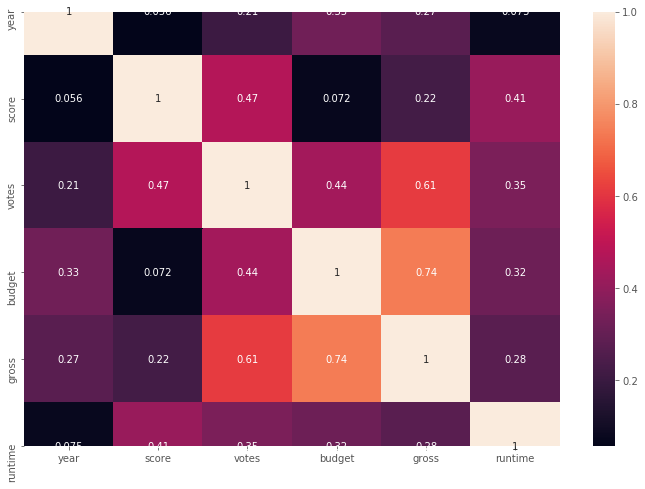

In [115]:
#let's plot a heatmap for this coorelation
sns.heatmap(Clean_data.corr(), annot=True)



In [118]:
# There can also be a coorelation between the name of the company and the gross. 
# But the thing is we have name of the company as string and not numeric, sp lets first do that and than lets plot it.
# We cant find coorelation between string and numeric, both of them should be numeric so we will use cat codes for this,
#If we have our data in Series or Data Frames, we can convert these categories to numbers using pandas Series’ astype method and specify ‘categorical’.
df_numerized=Clean_data
for col_name in df_numerized.columns:
    if (df_numerized[col_name].dtype == 'object'):
        df_numerized[col_name]=df_numerized[col_name].astype('category')
        df_numerized[col_name]=df_numerized[col_name].cat.codes
df_numerized
        
        
    

C:\Users\Admin\Anaconda3\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\Admin\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if __name__ == '__main__':


,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
0,4692,6,6,1980,1304,8.4,927000.0,1795,2832,699,46,19000000.0,4.699877e+07,1426,146.0
1,3929,6,1,1980,1127,5.8,65000.0,1578,1158,214,47,4500000.0,5.885311e+07,452,104.0
2,3641,4,0,1980,1359,8.7,1200000.0,757,1818,1157,47,18000000.0,5.383751e+08,945,124.0
3,204,4,4,1980,1127,7.7,221000.0,889,1413,1474,47,3500000.0,8.345354e+07,1108,88.0
4,732,6,4,1980,1170,7.3,108000.0,719,351,271,47,6000000.0,3.984634e+07,1083,98.0
5,1509,6,9,1980,1922,6.4,123000.0,1758,3081,155,47,550000.0,3.975460e+07,1108,95.0
6,3930,6,0,1980,1359,7.9,188000.0,974,576,860,47,27000000.0,1.152299e+08,1397,133.0
7,3122,6,3,1980,530,8.2,330000.0,1269,1257,1469,47,18000000.0,2.340243e+07,390,129.0
8,3732,4,0,1980,1346,6.8,101000.0,1606,1402,595,47,54000000.0,1.081857e+08,548,127.0
9,4401,6,3,1980,1755,7.0,10000.0,2011,280,402,47,10000000.0,1.579519e+07,1391,100.0


In [128]:
df_numerized.sort_values(by=['gross'], ascending=False)


,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
5445,386,5,0,2009,527,7.8,1100000.0,785,1263,1534,47,237000000.0,2.847246e+09,1382,162.0
7445,388,5,0,2019,137,8.4,903000.0,105,513,1470,47,356000000.0,2.797501e+09,983,181.0
3045,4909,5,6,1997,534,7.8,1100000.0,785,1263,1073,47,200000000.0,2.201647e+09,1382,194.0
6663,3643,5,0,2015,529,7.8,876000.0,768,1806,356,47,245000000.0,2.069522e+09,945,138.0
7244,389,5,0,2018,145,8.4,897000.0,105,513,1470,47,321000000.0,2.048360e+09,983,149.0
7480,4388,4,2,2019,1126,6.9,222000.0,1012,1361,457,47,260000000.0,1.670728e+09,1423,118.0
6653,2117,5,0,2015,1303,7.0,593000.0,335,2523,293,47,150000000.0,1.670516e+09,1397,124.0
6043,3878,5,0,2012,1899,8.0,1300000.0,1060,1646,1470,47,220000000.0,1.518816e+09,983,143.0
6646,1541,5,0,2015,165,7.1,370000.0,809,481,1785,47,190000000.0,1.515341e+09,1397,137.0
7494,1530,4,2,2019,2053,6.8,148000.0,277,1383,1036,47,150000000.0,1.450027e+09,1422,103.0


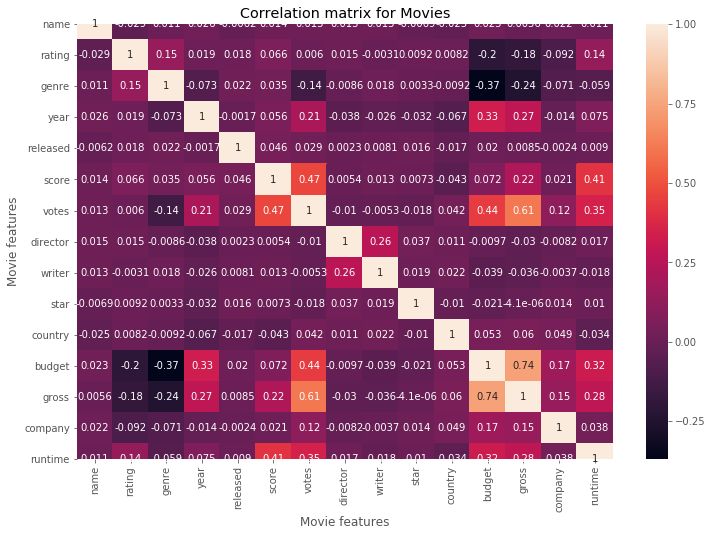

In [131]:
#lets plot a heatmap for this
sns.heatmap(df_numerized.corr(),annot=True)
plt.title("Correlation matrix for Movies")

plt.xlabel("Movie features")

plt.ylabel("Movie features")

plt.show()

In [132]:
# From the above we can convey a lot of things
# 1. Budget has a high coorelation with gross revenue
# 2.Votes and gross are coorelated,the higher the votes the more gross revenue it has.
# 3. Some of them also has negative coorelations.

In [137]:
# now that we have plotted the heatmap, lets get each pair for coorelation. lets unstack this
coorelation_pairs=df_numerized.corr().unstack()
coorelation_pairs
# Here we have the pairs for coorelation.

name      name        1.000000
          rating     -0.029234
          genre       0.010996
          year        0.025542
          released   -0.006152
          score       0.014450
          votes       0.012615
          director    0.015246
          writer      0.012880
          star       -0.006882
          country    -0.025490
          budget      0.023392
          gross       0.005639
          company     0.021697
          runtime     0.010850
rating    name       -0.029234
          rating      1.000000
          genre       0.147796
          year        0.019499
          released    0.018083
          score       0.065983
          votes       0.006031
          director    0.014656
          writer     -0.003149
          star        0.009196
          country     0.008230
          budget     -0.203946
          gross      -0.181906
          company    -0.092357
          runtime     0.140792
genre     name        0.010996
          rating      0.147796
        

In [139]:
# Now lets sort the pair
sorted_pairs=coorelation_pairs.sort_values()
sorted_pairs

budget    genre      -0.368523
genre     budget     -0.368523
          gross      -0.244101
gross     genre      -0.244101
budget    rating     -0.203946
rating    budget     -0.203946
          gross      -0.181906
gross     rating     -0.181906
genre     votes      -0.135990
votes     genre      -0.135990
company   rating     -0.092357
rating    company    -0.092357
genre     year       -0.073167
year      genre      -0.073167
genre     company    -0.071334
company   genre      -0.071334
year      country    -0.066748
country   year       -0.066748
genre     runtime    -0.059237
runtime   genre      -0.059237
country   score      -0.043051
score     country    -0.043051
budget    writer     -0.039466
writer    budget     -0.039466
director  year       -0.038354
year      director   -0.038354
writer    gross      -0.035885
gross     writer     -0.035885
country   runtime    -0.034477
runtime   country    -0.034477
star      year       -0.032157
year      star       -0.032157
director

In [143]:
# lets find the coorelation greater than 0.5
high_coorelation = sorted_pairs[(sorted_pairs) > 0.5]
high_coorelation
# we can convey that votes and gross has high coorelation and also budget and gross has highest coorelation

votes     gross       0.614751
gross     votes       0.614751
          budget      0.740247
budget    gross       0.740247
name      name        1.000000
director  director    1.000000
gross     gross       1.000000
budget    budget      1.000000
country   country     1.000000
star      star        1.000000
writer    writer      1.000000
votes     votes       1.000000
score     score       1.000000
released  released    1.000000
year      year        1.000000
genre     genre       1.000000
rating    rating      1.000000
company   company     1.000000
runtime   runtime     1.000000
dtype: float64

In [147]:
datacleaned=data.dropna()

In [148]:
datacleaned

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
0,The Shining,R,Drama,1980,"June 13, 1980 (United States)",8.4,927000.0,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000.0,4.699877e+07,Warner Bros.,146.0
1,The Blue Lagoon,R,Adventure,1980,"July 2, 1980 (United States)",5.8,65000.0,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000.0,5.885311e+07,Columbia Pictures,104.0
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,"June 20, 1980 (United States)",8.7,1200000.0,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000.0,5.383751e+08,Lucasfilm,124.0
3,Airplane!,PG,Comedy,1980,"July 2, 1980 (United States)",7.7,221000.0,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000.0,8.345354e+07,Paramount Pictures,88.0
4,Caddyshack,R,Comedy,1980,"July 25, 1980 (United States)",7.3,108000.0,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000.0,3.984634e+07,Orion Pictures,98.0
5,Friday the 13th,R,Horror,1980,"May 9, 1980 (United States)",6.4,123000.0,Sean S. Cunningham,Victor Miller,Betsy Palmer,United States,550000.0,3.975460e+07,Paramount Pictures,95.0
6,The Blues Brothers,R,Action,1980,"June 20, 1980 (United States)",7.9,188000.0,John Landis,Dan Aykroyd,John Belushi,United States,27000000.0,1.152299e+08,Universal Pictures,133.0
7,Raging Bull,R,Biography,1980,"December 19, 1980 (United States)",8.2,330000.0,Martin Scorsese,Jake LaMotta,Robert De Niro,United States,18000000.0,2.340243e+07,Chartoff-Winkler Productions,129.0
8,Superman II,PG,Action,1980,"June 19, 1981 (United States)",6.8,101000.0,Richard Lester,Jerry Siegel,Gene Hackman,United States,54000000.0,1.081857e+08,Dovemead Films,127.0
9,The Long Riders,R,Biography,1980,"May 16, 1980 (United States)",7.0,10000.0,Walter Hill,Bill Bryden,David Carradine,United States,10000000.0,1.579519e+07,United Artists,100.0


In [161]:
# Looking at the top 15 companies by gross revenue
companygross=datacleaned.groupby('company')[['gross']].sum()
top15=companygross.sort_values(by='gross', ascending=False)[:15]
top15

,gross
company,
Warner Bros.,5.461096e+10
Universal Pictures,5.124111e+10
Columbia Pictures,4.235643e+10
Paramount Pictures,4.002170e+10
Twentieth Century Fox,3.954257e+10
Walt Disney Pictures,3.583365e+10
New Line Cinema,1.961285e+10
Marvel Studios,1.506559e+10
DreamWorks Animation,1.187361e+10


In [166]:
top15.gross.dtype
top15.gross.astype('int64')

company
Warner Bros.                 54610959970
Universal Pictures           51241105418
Columbia Pictures            42356430218
Paramount Pictures           40021704691
Twentieth Century Fox        39542573303
Walt Disney Pictures         35833650748
New Line Cinema              19612851164
Marvel Studios               15065592411
DreamWorks Animation         11873612858
Dreamworks Pictures          11593807697
Touchstone Pictures          10664679494
Metro-Goldwyn-Mayer (MGM)     8937010092
Summit Entertainment          8318570396
Pixar Animation Studios       7886344526
Fox 2000 Pictures             7243673721
Name: gross, dtype: int64

In [168]:
#lets see which company had how much gross in which year
yearlygrossdata=datacleaned.groupby(['company','year'])[['gross']].sum()
yearlygrossdata

gross
company                                            year              
"DIA" Productions GmbH & Co. KG                    2003  4.435093e+07
"Weathering With You" Film Partners                2019  1.934575e+08
.406 Production                                    1996  1.058000e+04
1492 Pictures                                      1996  1.298324e+08
                                                   1999  8.742386e+07
1818 Productions                                   1983  1.223263e+07
19 Entertainment                                   2003  4.928883e+06
1978 Films                                         2017  4.065640e+07
1984 Private Defense Contractors                   2014  5.883438e+07
2 Loop Films                                       2002  2.643490e+05
2.0 Entertainment                                  2019  1.228104e+08
2.4.7. Films                                       2007  2.278398e+07
2003 Productions                                   2004  6.942439e+07
20th Century Studios                               2020  1.111055e+08
21 Laps Entertainment                              2014  4.129632e+07
                                                   2018  4.114238e+07
21st Century Film Corporation                      1990  5.835247e+06
21st Century Films                                 1994  1.702394e+06
25th Hour Productions                              2002  2.393206e+07
26 Films                                           2009  2.045887e+07
2929 Productions                                   2007  7.248490e+06
                                                   2008  2.870518e+07
                                                   2014  5.092129e+06
2DUX²                                              2016  6.781500e+05
                                                   2018  1.977444e+08
3 Arts Entertainment                               1996  6.020933e+07
                                                   1997  7.581243e+07
                                                   2001  7.118650e+07
                                                   2010  6.496260e+05
                                                   2013  3.909596e+06
                                                   2014  1.614593e+08
                                                   2015  3.660674e+07
                                                   2019  2.238656e+07
3 Miles Apart Productions Ltd.                     1999  8.408835e+06
3311 Productions                                   2017  5.042014e+06
360 Pictures                                       2007  9.669758e+06
3Mark Entertainment                                2001  4.760014e+06
4 Kids Entertainment                               1999  1.339493e+08
40 Acres & A Mule Filmworks                        1986  7.137502e+06
                                                   1989  3.729544e+07
                                                   1995  1.540344e+07
                                                   1999  3.457378e+07
                                                   2000  2.772812e+07
                                                   2004  1.526951e+06
4Kids Entertainment                                2007  9.580292e+07
7 Arts International                               1999  2.061280e+05
7 Films Cinéma                                     2000  3.033646e+06
88 Productions                                     1990  1.000597e+07
888 Productions                                    1990  2.019659e+08
900 Films                                          2003  5.141166e+06
98 MPH Productions                                 2002  8.069354e+07
A Band Apart                                       1995  3.734870e+06
                                                   1996  4.962000e+04
                                                   2002  1.494615e+07
A&M Films                                          1984  1.455045e+06
                                                   1988  1.610040e+05
    

In [169]:
#lets sort it with years
yearlygrossdata.sort_values(by='year',ascending=True)

,,gross
company,year,
Walt Disney Productions,1980,1.100000e+07
Lorimar Film Entertainment,1980,1.981452e+07
American Cinema Productions,1980,1.897100e+07
Dovemead Films,1980,1.081857e+08
Columbia Pictures,1980,5.885311e+07
Bryna Productions,1980,1.664780e+07
Paramount Pictures,1980,2.505418e+08
Melvin Simon Productions,1980,7.063886e+06
Borough Park Productions,1980,5.916700e+04
